In [1]:
## Perform clinical annotation-based comparison 
## INPUTS:
# factorizations = already computed factirizations
# clinical = clinical information associated with samples
# col = columns in clinical data on which the analysis will be performed
## OUPUTS: a list containing output values
# selectivity = Selectivity (fraction of significant annotations per all significant factors)
# nonZeroFacs = Number of unique factors that were significant at least once
# total_pathways = Number of clinical annotations with at least one significant factor component
##执行基于临床注释的比较
##输入：
#factorizations=已计算的因式分解
#clinical=与样本相关的临床信息
#col=将对其执行分析的临床数据列
##输出：包含输出值的列表
#selectivity=选择性（每个重要因素的重要注释分数）
#nonZeroFacs=至少一次显著的唯一因素的数量
#total_pathways=至少有一个显著因子成分的临床注释数
clinical_comparison <- function(factorizations, clinical, col){

    # Empty containers
    line <- numeric(0)
    line2 <- numeric(0)
    line3 <- numeric(0)

    # For each factorization
    for(i in 1:length(factorizations)){

        # Extract sample association
        factors <- factorizations[[i]][[1]]
        if(is.null(names(factors))) { names(factors) <- 1:ncol(factors) }
        if(is.null(colnames(factors))) { colnames(factors) <- 1:ncol(factors) }

        # Patient names in factorisation results
        patient.names <- rownames(factors)
        # Patient names in original data
        patient.names.in.file <- as.character(clinical[, 1])
        patient.names.in.file <- toupper(gsub('-', '\\.', patient.names.in.file))
        # Remove non-matching patient names
        is_in_file <- patient.names %in% patient.names.in.file
        if(length(patient.names)!=sum(is_in_file)) {
            factors <- factors[is_in_file, ]
            patient.names <- patient.names[is_in_file]
            rownames(factors)<-patient.names
        }
        # Match indices of patient names
        indices <- match(patient.names, patient.names.in.file)
        # Use indices to extract coresponding survival information
        ordered.clinical.data <- clinical[indices,]        
        
        # Only use column names that are really present in the data
        col_new <- col[col %in% colnames(ordered.clinical.data)]

        # Stor all p-values
        pvalues <- numeric(0)
        # Store number of significant annotations
        clin_erich <- 0 
        
        # Test significance association with clinical annotations
        for(j in col_new){
            
            # Perform the analysis if there is more than one possible value in current column
            table_values <- table(ordered.clinical.data[,j])
            if(sum(table_values>0)>1){

                if(j == "age_at_initial_pathologic_diagnosis" ){
                    pvalues_col <- apply(factors, MARGIN=2, 
                                       function(x) kruskal.test(x~cut(as.numeric(ordered.clinical.data[,j]),
                                                                      5, include.lowest=TRUE))$p.value)
                    pvalues <- c(pvalues, pvalues_col)
                    if(min(pvalues_col)<0.05){
                        clin_erich <- clin_erich+1
                    }
                }else if(j == "days_to_new_tumor_event_after_initial_treatment"){
                    pvalues_col <- apply(factors,MARGIN=2, 
                                       function(x) kruskal.test(x~cut(as.numeric(ordered.clinical.data[,j]), 
                                                                      3, include.lowest=TRUE))$p.value)
                    pvalues <- c(pvalues, pvalues_col)
                    if(min(pvalues_col)<0.05){
                        clin_erich <- clin_erich+1
                    }
                }else if(j == "gender" || j == "history_of_neoadjuvant_treatment"){
                    pvalues_col <- apply(factors, MARGIN=2, 
                                       function(x) wilcox.test(x~ordered.clinical.data[,j])$p.value)
                    pvalues <- c(pvalues, pvalues_col)
                    if(min(pvalues_col)<0.05){
                        clin_erich <- clin_erich+1
                    }
                }
            }
        }
        
        # Number of clinical annotations with at least one significant p-value
        line3 <- rbind(line3, clin_erich)

        # Total number of significant factors in all tested columns
        column <- names(pvalues)[pvalues<0.05]
        # Number of unique factors that were significant at least once
        line2<-rbind(line2, length(unique(column)))

        # Number of times a p-value was found significant
        signif <- length(column)
        f<-length(unique(column))                                 
        # Selectivity 
        if(signif!=0){
            line <- rbind(line,((clin_erich/signif)+(f/signif))/2)
        }else{
            line <- rbind(line,0)
        }

    }
    
    # Store and return results
    out <- data.frame(selectivity=line, nonZeroFacs=line2, total_pathways=line3)
#    print(out)
    return(out)
}

In [2]:
library('survival')

## Perform survival annotation-based comparison 
## INPUTS:
# factorizations = already computed factirizations
# method = methods used for factorization
# survival = survival data associated to the cancer
# out.folder = folder where results will be written
# cancer = name of currently analysed cancer
## OUPUTS: a list containing output values

##执行基于注释的比较
##输入：
#factorizations=已计算的因式分解
#method=用于因子分解的方法
#survival=与癌症相关的生存数据
# out.folder文件夹=将写入结果的文件夹
#cancer=当前分析癌症的名称
##输出：包含输出值的列表
survival_comparison <- function(factorizations, method, survival, out.folder, cancer){
    
    # Initialize result containers
    factors_cancer <- numeric(0)
    surv_final <- numeric(0)
    
    # Adjust sample names for breast survival dataset
    if(cancer=="breast"){survival[,1] <- paste0(survival[,1],"-01")}
    
    # For each computed factorisation
    for(i in 1:length(factorizations)){

        # Extract sample factors 
        factors <- factorizations[[i]][[1]]

        # Patient names in factorisation results
        patient.names <- rownames(factors)
        # Patient names in original data
        patient.names.in.file <- as.character(survival[, 1])
        patient.names.in.file <- toupper(gsub('-', '\\.', patient.names.in.file))
        # Remove non-matching patient names
        is_in_file <- patient.names %in% patient.names.in.file
        if(length(patient.names)!=sum(is_in_file)) {
            factors <- factors[is_in_file, ]
            patient.names <- patient.names[is_in_file]
            rownames(factors)<-patient.names
        }
        # Match indices of patient names
        indices <- match(patient.names, patient.names.in.file)
        # Use indices to extract coresponding survival information
        ordered.survival.data <- survival[indices,]
        # Clean data (assign 0 to NAs)
        ordered.survival.data$Survival[is.na(ordered.survival.data$Survival)] <- 0
        ordered.survival.data$Death[is.na(ordered.survival.data$Death)] <- 0

        # Calculate coxph
        coxph_obj <- coxph(Surv(ordered.survival.data$Survival, ordered.survival.data$Death) ~ factors)
        # P-values (corrected by the number of methods)
        pvalues <- length(factorizations)*as.matrix(coef(summary(coxph_obj))[,5])

        # How many significant? 
        factors_cancer <- c(factors_cancer, sum(pvalues<0.05))
        # Store p-values
        surv_final <- cbind(surv_final, pvalues) 
    }
    # Keep -log10 of p-values
    surv_final<-(-log10(surv_final))
    # Plot survival pvalues for each cancer type separately
    png(file=paste0(out.folder, "survival_", cancer, ".png"), width = 15, height = 15, units = 'in', res = 200)
    matplot(1:length(method), t(surv_final), 
            col="black", pch=18, xlab="Method", ylab="Pvalues survival", xaxt="none", cex=1.5)
    abline(h = (-log10(0.05)), v=0, col="black", lty=3, lwd=3)
    axis(1, at=1:length(method), labels=colnames(surv_final)) 
    dev.off()

#    print(factors_cancer)
    return(factors_cancer)
}

In [3]:
library("fgsea", quietly = TRUE)

## Perform biological annotation-based comparison 
## INPUTS:
# factorizations = already computed factirizations
# path.database = path to a GMT annotation file
# pval.thr = p-value threshold (default to 0.05)
## OUPUTS: a list containing output values
# selectivity = Selectivity (fraction of significant annotations per all significant factors)
# nonZeroFacs = Number of unique factors that were significant at least once
# total_pathways = Number of clinical annotations with at least one significant factor component
biological_comparison <- function(factorizations, path.database, pval.thr=0.05){
    
    # Load annotation database
    pathways <- gmtPathways(path.database)
    
    # Containers to report results
    report_number <- numeric(0)
    report_nnzero <- numeric(0)
    report_select <- numeric(0)
    
    # For each factorization method
    for(i in 1:length(factorizations)){
        
        # Extract metagenes found by factorization method
        metagenes<-factorizations[[i]][[2]][[1]]
        # Number of factors
        num.factors <- ncol(metagenes)
        # Rename columns
        colnames(metagenes)<-1:num.factors
        # Rename rows to remove "|" characters and keep only the gene name before
        rownames(metagenes)<-gsub("\\|",".",rownames(metagenes))
        rownames(metagenes)<-gsub("\\..*","",rownames(metagenes))
        # Remove duplicated gene names that could confuse fgsea
        duplicated_names <- unique(rownames(metagenes)[duplicated(rownames(metagenes))])
        metagenes <- metagenes[!(rownames(metagenes) %in% duplicated_names), ]

        # Variables
        min_pval <- numeric(0)
        path <- numeric(0)
        n <- 0
        
        # Calculate biological annotation enrichment.
        # For each factor,
        for(j in 1:num.factors){
            # Assign gene names
            rnk <- setNames(as.matrix(metagenes[,j]), rownames(metagenes))
            # Compute fgsea
            fgseaRes <- fgsea(pathways, rnk, minSize=15, maxSize=500, nperm=1000)
            # If at least one pathway is significant
            if(sum(fgseaRes$padj < pval.thr)!=0){
                # Count this factor
                n <- n+1
                # Keep min adjusted p-value
                min_pval <- rbind(min_pval, min(fgseaRes$padj))
                # Keep names of significant pathways
                path <- c(path, fgseaRes[fgseaRes$padj<pval.thr, "pathway"])
            } else {
                min_pval <- rbind(min_pval, NA)
            }
        }

        # Report number of unique significant pathways  
        if(length(path)==0){
            report_number <- rbind(report_number, 0)
        }else{
            report_number <- rbind(report_number, length(unique(path)))
        }
        # Report selectivity 
        if(length(unique(path))==0){
            report_select <- rbind(report_select, NA)
        }else{
            al<-length(unique(path))/length(path)
            fl<-length(which(!is.na(min_pval)))/length(path)
            report_select <- rbind(report_select, (al+fl)/2)
        }
        # Report number of factors associated with at least one significant pathway
        report_nnzero<-rbind(report_nnzero, n)    
    
    }
    
    out <- data.frame(selectivity=report_select, nonZeroFacs=report_nnzero, total_pathways=report_number)
#    print(out)
    return(out)
}

In [4]:
# Load the function running the factorization, plus a support function
source("runfactorization.R")
source("log2matrix.R")

# List downloaded cancer data.
# Folder structure should be organized as discussed above.
# Exclude first result as it's the parent folder
# cancers <- list.dirs(path = "../data/cancertest", full.names = TRUE, recursive = TRUE)[-1]
# cancer_names <- list.dirs(path = "../data/cancertest", full.names = FALSE, recursive = TRUE)[-1]

cancers <- list.dirs(path = "../data/cancer4", full.names = TRUE, recursive = TRUE)[-1]
cancer_names <- list.dirs(path = "../data/cancer4", full.names = FALSE, recursive = TRUE)[-1]

# Annotation databases used for biological enrichment
path.database <- "../data/bio_annotations/c2.cp.reactome.v6.2.symbols.gmt" #REACTOME
#path.database <- "../data/bio_annotations/h.all.v6.2.symbols.gmt" #Hallmarks
#path.database <- "../data/bio_annotations/c5.all.v6.2.symbols.gmt" #GO

# Label to identify current run
tag <- format(Sys.time(), "%Y%m%d%H%M%S")
# Folder for comparison results
results_folder <- paste0("../results", tag, "/")
# Create output folder
dir.create(results_folder, showWarnings = FALSE)

# Number of factors used in the paper
num.factors <- 10

# Initialize result containers
clinical_analysis <- data.frame(
    matrix(data = NA, ncol=5, nrow=0, 
           dimnames = list(c(), c("methods", "cancer", "selectivity", "nonZeroFacs", "total_pathways"))
          ),
    stringsAsFactors = FALSE)

biological_analysis <- data.frame(
    matrix(data = NA, ncol=5, nrow=0, 
           dimnames = list(c(), c("methods", "cancer", "selectivity", "nonZeroFacs", "total_pathways"))
          ),
    stringsAsFactors = FALSE)
cancer.list <- list()

# Clinical categories to be used for clinical tests
col <- c("age_at_initial_pathologic_diagnosis",
         "gender",
         "days_to_new_tumor_event_after_initial_treatment",
         "history_of_neoadjuvant_treatment")

Loading required package: MASS

Loading required package: NMF

Loading required package: pkgmaker

Loading required package: registry

Loading required package: rngtools

Loading required package: cluster

NMF - BioConductor layer [OK] | Shared memory capabilities [NO: bigmemory] | Cores 27/28

  To enable shared memory capabilities, try: install.extras('
NMF
')

Loading required package: mclust

Package 'mclust' version 5.4.6
Type 'citation("mclust")' for citing this R package in publications.

Loading required package: InterSIM

Loading required package: tools

Loading required package: ade4


Attaching package: ‘ade4’


The following object is masked from ‘package:BiocGenerics’:

    score



Attaching package: ‘GPArotation’


The following object is masked from ‘package:NMF’:

    entropy



Attaching package: ‘MOFAtools’


The following objects are masked from ‘package:NMF’:

    featureNames, featureNames<-, predict, sampleNames, sampleNames<-


The following objects are masked f

In [5]:
print(cancers)

[1] "../data/cancer4/gbm"


In [6]:
##### runfactoization runs all the considered multi-omics factorization
### the required inputs are:
### "folder" corresponding to the path to the folder where the input files are contained, in the idea that all omics matrices are organized inside a unique folder
### "file.names" corresponding to a vector containing the names of all the omics files
### "num.factors" containing the number of factors in which we desire to decompose the matrices
### "sep=" "" corresponding to the separator used in the omics files required to properly read them
### "single.cell" indicating if the data are single cell data. In this case the filtering of the data will be more intense in respect to other data types
### "filtering"

### the input files need to be log2 transformed before running the analysis


library("RGCCA")
library("r.jive")
library("IntNMF")
library("omicade4")
library("MSFA")
library("GPArotation")
library("MOFAtools")
library("tensorBSS")
source("tICA.R")
library("iCluster")

testrunfactorization <- function(folder,file.names,num.factors,sep=" ",filtering="none"){
  factorizations<-list()
  t<-1
  method<-numeric(0)
  
  num.factors<-as.numeric(num.factors)

  
  ##creating list of omics
  omics <- list()
  for(i in 1:length(file.names)){
    omics[[i]]<-as.matrix(read.table(paste(folder,file.names[i],sep="/"),sep=sep,row.names=1,header=T))
    print(colnames(omics[[i]])) 
  }
  
  ####
  #omics<-lapply(omics, function(x) t(x))
  ######
  
  ##restricting to common samples and filtering
  samples<-colnames(omics[[1]])
  for(j in 1:length(omics)){
    samples<-intersect(samples,colnames(omics[[j]]))
  }
  for(j in 1:length(omics)){
    omics[[j]]<-omics[[j]][,samples]
    if(filtering!="none"){
      x<-apply( omics[[j]],1,sd)
      x<-as.matrix(sort(x, decreasing = T))
      w<-which(x>0)
      if(filtering=="stringent"){
        selected<-rownames(x)[1:min(w[length(w)],5000)]
      }else{
        selected<-rownames(x)[1:min(w[length(w)],6000)]
      }
      m<-match(rownames(omics[[j]]),selected)
      w<-which(!is.na(m))
      omics[[j]]<-omics[[j]][w,]
    }else{
      omics[[j]]<-omics[[j]][which(apply(omics[[j]],2,sd)>0),]
    }
  }
#   print(omics)
#   write.table(omics, file = paste(basename(folder),"omics.txt"), 
#             sep="\t", col.names=FALSE, row.names=FALSE, quote=FALSE)  
 
#   ##RGCCA 
#   factorizations_RGCCA<-rgcca(lapply(omics, function(x) t(x)), ncomp = rep(num.factors, length(omics)), scheme = "centroid", scale = TRUE, init = "svd",bias = TRUE, tol = 1e-08, verbose = F)
#   factors_rgcca<-as.matrix(factorizations_RGCCA$Y[[1]])
#   metagenes_rgcca <- list()
#   for(j in 1:length(omics)){
#     metagenes_rgcca[[j]]<-as.matrix(factorizations_RGCCA$a[[j]])
#     rownames(metagenes_rgcca[[j]])<-rownames(omics[[j]])
#     colnames(metagenes_rgcca[[j]])<-1:num.factors
#   }
#   factorizations[[t]]<-list(factors_rgcca,metagenes_rgcca)
#   t<-t+1
#   method<-c(method,"RGCCA")
  

  
  
#   out<-list(factorizations=factorizations,method=method)
  
#   return(out)
    return(omics)
}


In [7]:

# For each cancer dataset
for(i in cancers){

    print(paste0("Now analysing ", i))
    
    # Name of current cancer
    current_cancer <- basename(i)
    
    # If the expression and miRNA data are not log2-transformed as for those provided by XX et al.
    log2matrix(i,"exp")
    log2matrix(i,"mirna")

    # Perform factorisation
    print("Running factorisation...")
    omics <- testrunfactorization(i, c("log_exp","methy","log_mirna"), num.factors, sep=" ", filtering="sd")
    write.table(omics[[1]], file = paste(i,"/log_exp_omics.txt",sep=""), 
            sep="\t", col.names=colnames(omics[[1]]), row.names=FALSE,quote=FALSE)
    write.table(omics[[2]], file = paste(i,"/methy_omics.txt",sep=""), 
            sep="\t", col.names=colnames(omics[[2]]), row.names=FALSE,quote=FALSE)
    write.table(omics[[3]], file = paste(i,"/log_mirna_omics.txt",sep=""), 
            sep="\t", col.names=colnames(omics[[3]]), row.names=FALSE,quote=FALSE)
    
    
#     # Survival analysis
#     print("Running survival analysis...")
#     survival <- read.table(paste0(i, "/survival"), sep="\t", header=TRUE, stringsAsFactors=FALSE)
#     print(survival)
#     out_survival <- survival_comparison(out$factorizations, out$method, survival, 
#                                         results_folder, current_cancer)
#     print(out_survival)
    
#     # Clinical analysis
#     print("Running clinical analysis...")
#     clinical <- read.table(paste0("../data/clinical/", current_cancer), sep="\t", header=TRUE)
#     print(clinical)
#     out_clinical <- clinical_comparison(out$factorizations, clinical, col)
#     print(out_clinical)
#     clinical_analysis <- rbind(clinical_analysis,
#                                 data.frame(methods=out$method, cancer=current_cancer, out_clinical))    

#     # Biological analysis
#     print("Running biological analysis...")
#     out_bio <- biological_comparison(out$factorizations, path.database, pval.thr=0.05)
#     print(out_bio)
#     biological_analysis <- rbind(biological_analysis,
#                                 data.frame(methods=out$method, cancer=current_cancer, out_bio))    
}
# rownames(clinical_analysis) <- c()
# rownames(biological_analysis) <- c()

[1] "Now analysing ../data/cancer4/gbm"
[1] "Running factorisation..."
  [1] "probe.TCGA.02.0001.01" "TCGA.02.0003.01"       "TCGA.02.0004.01"      
  [4] "TCGA.02.0007.01"       "TCGA.02.0009.01"       "TCGA.02.0010.01"      
  [7] "TCGA.02.0011.01"       "TCGA.02.0014.01"       "TCGA.02.0015.01"      
 [10] "TCGA.02.0016.01"       "TCGA.02.0021.01"       "TCGA.02.0023.01"      
 [13] "TCGA.02.0024.01"       "TCGA.02.0025.01"       "TCGA.02.0026.01"      
 [16] "TCGA.02.0027.01"       "TCGA.02.0028.01"       "TCGA.02.0033.01"      
 [19] "TCGA.02.0034.01"       "TCGA.02.0038.01"       "TCGA.02.0039.01"      
 [22] "TCGA.02.0043.01"       "TCGA.02.0046.01"       "TCGA.02.0047.01"      
 [25] "TCGA.02.0048.01"       "TCGA.02.0051.01"       "TCGA.02.0052.01"      
 [28] "TCGA.02.0054.01"       "TCGA.02.0057.01"       "TCGA.02.0058.01"      
 [31] "TCGA.02.0059.01"       "TCGA.02.0060.01"       "TCGA.02.0064.01"      
 [34] "TCGA.02.0068.01"       "TCGA.02.0069.01"       "TCGA.02.0070.01"

In [22]:
omics[3]

,TCGA.AB.2805.03,TCGA.AB.2806.03,TCGA.AB.2807.03,TCGA.AB.2808.03,TCGA.AB.2810.03,TCGA.AB.2811.03,TCGA.AB.2812.03,TCGA.AB.2813.03,TCGA.AB.2814.03,TCGA.AB.2815.03,⋯,TCGA.AB.3000.03,TCGA.AB.3001.03,TCGA.AB.3002.03,TCGA.AB.3005.03,TCGA.AB.3006.03,TCGA.AB.3007.03,TCGA.AB.3008.03,TCGA.AB.3009.03,TCGA.AB.3011.03,TCGA.AB.3012.03
hsa.let.7a.1,12.715430,12.811416,13.230721,12.5525857,12.790485,12.5273707,13.602922,12.840970,13.583858,12.618593,⋯,12.898453,13.345486,13.340248,13.163531,13.296795,13.356762,12.673432,13.052880,13.1668325,13.338725
hsa.let.7a.2,13.696212,13.775044,14.227211,13.5230459,13.767643,13.5066055,14.548318,13.814696,14.621295,13.626447,⋯,13.921393,14.358708,14.312111,14.164012,14.250824,14.406941,13.623503,14.012697,14.1587299,14.394529
hsa.let.7a.3,12.721858,12.814301,13.241966,12.5715626,12.798346,12.5409060,13.591031,12.833313,13.624976,12.688261,⋯,12.875602,13.311671,13.338969,13.232367,13.289756,13.339979,12.641468,13.038021,13.2008719,13.350580
hsa.let.7b,13.743127,13.430941,14.373426,13.0109349,15.387414,13.3741092,15.291224,14.156763,15.535754,13.244788,⋯,13.985672,13.173117,14.488805,15.162574,14.922814,13.522039,13.476858,13.631448,15.1641595,13.268334
hsa.let.7c,5.906804,5.682879,13.147109,9.7890946,6.293097,8.4727462,9.932686,8.691620,11.950048,9.561558,⋯,10.861120,6.848208,12.619330,6.972157,10.478084,5.987881,11.087536,6.639265,6.2807458,7.696080
hsa.let.7d,11.960316,12.402785,11.718985,11.9670443,10.972866,11.4727735,11.415654,11.838003,11.762728,11.962228,⋯,11.844377,11.711525,12.336762,10.529281,11.810268,12.304760,11.689370,11.947013,11.4395985,11.769430
hsa.let.7e,9.719457,9.093931,10.314929,8.2646352,9.513972,7.3157958,9.988865,9.456817,9.706025,8.979764,⋯,7.539445,9.420271,10.723907,9.043527,8.986207,9.652185,8.795792,10.155071,9.2298203,10.469154
hsa.let.7f.1,5.713910,5.761530,6.359615,5.7383247,5.405248,5.7418048,5.314974,5.620883,5.950829,5.993070,⋯,6.524704,7.111564,6.836660,5.856455,5.940375,6.093172,6.674288,7.191020,6.1876717,6.744686
hsa.let.7f.2,12.444640,12.716508,12.921338,13.1187093,11.968188,13.5130036,12.873670,12.714163,12.967785,12.903791,⋯,12.837073,13.141232,13.252887,12.180376,12.691871,13.162909,12.820008,13.261704,12.3384872,12.735780
hsa.let.7g,11.551341,11.672882,12.208792,12.2484863,11.062033,11.9867567,11.771379,11.867775,11.881894,11.774185,⋯,12.078897,12.223734,12.198859,11.276934,12.021598,11.476314,12.127895,12.462696,11.3447060,11.734182


In [19]:
write.table(omics, file = paste(basename(folder),"omics.txt"), 
            sep="\t", quote=FALSE) 

ERROR: Error in (function (..., row.names = NULL, check.rows = FALSE, check.names = TRUE, : arguments imply differing number of rows: 6000, 5000, 558


In [6]:
library("RGCCA")
library("r.jive")
library("IntNMF")
library("omicade4")
library("MSFA")
library("GPArotation")
library("MOFAtools")
library("tensorBSS")
source("tICA.R")
library("iCluster")

runfactorization1 <- function(folder,file.names,num.factors,sep=" ",filtering="none"){
  factorizations<-list()
  t<-1
  method<-numeric(0)
  
  num.factors<-as.numeric(num.factors)

  
  ##creating list of omics
  omics <- list()
  for(i in 1:length(file.names)){
    omics[[i]]<-as.matrix(read.table(paste(folder,file.names[i],sep="/"),sep=sep,row.names=1,header=T))
  }
  
  ####
  #omics<-lapply(omics, function(x) t(x))
  ######
  
  ##restricting to common samples and filtering
  samples<-colnames(omics[[1]])
  for(j in 1:length(omics)){
    samples<-intersect(samples,colnames(omics[[j]]))
  }
  for(j in 1:length(omics)){
    omics[[j]]<-omics[[j]][,samples]
    if(filtering!="none"){
      x<-apply( omics[[j]],1,sd)
      x<-as.matrix(sort(x, decreasing = T))
      w<-which(x>0)
      if(filtering=="stringent"){
        selected<-rownames(x)[1:min(w[length(w)],5000)]
      }else{
        selected<-rownames(x)[1:min(w[length(w)],6000)]
      }
      m<-match(rownames(omics[[j]]),selected)
      w<-which(!is.na(m))
      omics[[j]]<-omics[[j]][w,]
    }else{
      omics[[j]]<-omics[[j]][which(apply(omics[[j]],2,sd)>0),]
    }
  }  
  
 
  ##RGCCA 
  factorizations_RGCCA<-rgcca(lapply(omics, function(x) t(x)), ncomp = rep(num.factors, length(omics)), scheme = "centroid", scale = TRUE, init = "svd",bias = TRUE, tol = 1e-08, verbose = F)
  factors_rgcca<-as.matrix(factorizations_RGCCA$Y[[1]])
  metagenes_rgcca <- list()
  for(j in 1:length(omics)){
    metagenes_rgcca[[j]]<-as.matrix(factorizations_RGCCA$a[[j]])
    rownames(metagenes_rgcca[[j]])<-rownames(omics[[j]])
    colnames(metagenes_rgcca[[j]])<-1:num.factors
  }
  factorizations[[t]]<-list(factors_rgcca,metagenes_rgcca)
  t<-t+1
  method<-c(method,"RGCCA")
  
  ###MCIA
  omics_pos<-list()
  for(j in 1:length(omics)){
    if(min(omics[[j]])<0){
      omics_pos[[j]]<-omics[[j]]+abs(min(omics[[j]]))
    }else{
      omics_pos[[j]]<-omics[[j]]
    }
    omics_pos[[j]]<-omics_pos[[j]]/max(omics_pos[[j]])
  }
  factorizations_mcia<-mcia(omics_pos, cia.nf = num.factors)
  factors_mcia<-as.matrix(factorizations_mcia$mcoa$SynVar)
  metagenes_mcia<-list()
  for(j in 1:length(omics)){
    metagenes_mcia[[j]]<-as.matrix(factorizations_mcia$mcoa$axis[1:dim(omics[[j]])[1],])
    rownames(metagenes_mcia[[j]])<-rownames(omics[[j]])
    colnames(metagenes_mcia[[j]])<-1:num.factors
  }
  factorizations[[t]]<-list(factors_mcia,metagenes_mcia)
  t<-t+1
  method<-c(method,"MCIA")
  
  
  
  
  out<-list(factorizations=factorizations,method=method)
  
  return(out)
}


In [7]:
# For each cancer dataset
for(i in cancers){

    print(paste0("Now analysing ", i))
    
    # Name of current cancer
    current_cancer <- basename(i)

    # If the expression and miRNA data are not log2-transformed as for those provided by XX et al.
    log2matrix(i,"exp")
    log2matrix(i,"mirna")

    # Perform factorisation
    print("Running factorisation...")
    out <- runfactorization1(i, c("log_exp","methy","log_mirna"), num.factors, sep=" ", filtering="sd")
    print(out)
    # Survival analysis
    print("Running survival analysis...")
    survival <- read.table(paste0(i, "/survival"), sep="\t", header=TRUE, stringsAsFactors=FALSE)
    print(survival)
    out_survival <- survival_comparison(out$factorizations, out$method, survival, 
                                        results_folder, current_cancer)
    print(out_survival)
    
    # Clinical analysis
    print("Running clinical analysis...")
    clinical <- read.table(paste0("../data/clinical/", current_cancer), sep="\t", header=TRUE)
    print(clinical)
    out_clinical <- clinical_comparison(out$factorizations, clinical, col)
    print(out_clinical)
    clinical_analysis <- rbind(clinical_analysis,
                                data.frame(methods=out$method, cancer=current_cancer, out_clinical))    

    # Biological analysis
    print("Running biological analysis...")
    out_bio <- biological_comparison(out$factorizations, path.database, pval.thr=0.05)
    print(out_bio)
    biological_analysis <- rbind(biological_analysis,
                                data.frame(methods=out$method, cancer=current_cancer, out_bio))    
}
rownames(clinical_analysis) <- c()
rownames(biological_analysis) <- c()

[1] "Now analysing ../data/cancer1/aml"
[1] "Running factorisation..."
$factorizations
$factorizations[[1]]
$factorizations[[1]][[1]]
                       comp1        comp2         comp3        comp4
TCGA.AB.2805.03 -0.262167473 -0.218321995 -0.3487855017  0.012218663
TCGA.AB.2806.03 -0.098899112  0.493874880 -0.3998846453 -0.051217663
TCGA.AB.2807.03  0.579932426 -0.054806813 -0.0987132933 -0.071017676
TCGA.AB.2808.03 -0.043101258  0.174386648 -0.2957582267  0.071356349
TCGA.AB.2810.03 -0.177099646  0.223416796  0.3808001704  0.079994136
TCGA.AB.2811.03 -0.471555095 -0.167436862  0.1715151278 -0.034385189
TCGA.AB.2812.03 -0.461382182  0.417825949  0.2195247153 -0.318852257
TCGA.AB.2813.03 -0.001419536 -0.402986686 -0.1363856176  0.161077590
TCGA.AB.2814.03  0.127449866  0.174843815 -0.0752609664 -0.179936417
TCGA.AB.2815.03 -0.289196180 -0.121489897 -0.4055684366  0.228371078
TCGA.AB.2816.03 -0.676567481 -0.164990907 -0.0120404350  0.022750135
TCGA.AB.2817.03  0.304022227 -0.202929

[1] 2 2
[1] "Running clinical analysis..."
           sampleID
1   TCGA-AB-2802-03
2   TCGA-AB-2803-03
3   TCGA-AB-2804-03
4   TCGA-AB-2805-03
5   TCGA-AB-2806-03
6   TCGA-AB-2807-03
7   TCGA-AB-2808-03
8   TCGA-AB-2809-03
9   TCGA-AB-2810-03
10  TCGA-AB-2811-03
11  TCGA-AB-2812-03
12  TCGA-AB-2813-03
13  TCGA-AB-2814-03
14  TCGA-AB-2815-03
15  TCGA-AB-2816-03
16  TCGA-AB-2817-03
17  TCGA-AB-2818-03
18  TCGA-AB-2819-03
19  TCGA-AB-2820-03
20  TCGA-AB-2821-03
21  TCGA-AB-2822-03
22  TCGA-AB-2823-03
23  TCGA-AB-2824-03
24  TCGA-AB-2825-03
25  TCGA-AB-2826-03
26  TCGA-AB-2827-03
27  TCGA-AB-2828-03
28  TCGA-AB-2829-03
29  TCGA-AB-2830-03
30  TCGA-AB-2831-03
31  TCGA-AB-2832-03
32  TCGA-AB-2833-03
33  TCGA-AB-2834-03
34  TCGA-AB-2835-03
35  TCGA-AB-2836-03
36  TCGA-AB-2837-03
37  TCGA-AB-2838-03
38  TCGA-AB-2839-03
39  TCGA-AB-2840-03
40  TCGA-AB-2841-03
41  TCGA-AB-2842-03
42  TCGA-AB-2843-03
43  TCGA-AB-2844-03
44  TCGA-AB-2845-03
45  TCGA-AB-2846-03
46  TCGA-AB-2847-03
47  TCGA-AB-2848-

In [10]:
out$factorizations[[1]][[2]][[1]]

,1,2,3,4,5,6,7,8,9,10
X..100133144,0.0118073590,-0.0006870161,1.229800e-02,-0.011837724,3.670062e-03,0.0206838527,0.018085311,0.0095373988,0.009522183,0.0043744251
X..100134869,0.0154943923,0.0079182816,8.517748e-03,-0.007795842,7.982904e-03,0.0157720794,0.011924304,0.0053104031,0.010099067,0.0117385558
X..388795,-0.0006439904,-0.0027105411,9.564813e-03,0.020363662,6.641580e-03,-0.0041138375,0.015993005,0.0173629078,0.026833175,0.0074523283
X..652919,0.0089759885,0.0013385932,6.350516e-03,-0.011841289,-9.725803e-03,-0.0043302341,-0.008116855,-0.0129306361,0.005206531,0.0070735225
X..653553,0.0060857588,-0.0071241776,-3.756550e-03,-0.005177558,-5.576028e-03,-0.0281048783,-0.020242474,0.0194943807,0.009947612,-0.0043189888
X..728788,0.0092913058,-0.0014460868,6.170569e-03,-0.008869450,1.234281e-02,0.0094810179,0.006562174,-0.0123203172,-0.007813349,0.0038709077
X..90288,0.0142861915,0.0066291059,1.197967e-02,-0.011318343,5.293515e-03,-0.0025656223,-0.016368162,-0.0132414034,0.001861788,-0.0359446878
A2ML1.144568,0.0073030864,-0.0051392639,4.385504e-03,-0.013499067,-4.417516e-03,-0.0100965768,0.007363751,0.0163989967,0.014882546,-0.0065522503
A2M.2,0.0186013256,-0.0090325536,-6.768492e-03,0.009786549,1.046571e-02,0.0142175527,-0.016234156,0.0093233376,-0.016351448,-0.0067730234
A4GALT.53947,0.0173362117,0.0006714102,1.407889e-03,-0.002448164,6.146704e-03,0.0196987189,-0.011292320,0.0251229094,-0.009660776,-0.0054170768


In [22]:
# Export results into separated tables
write.table(biological_analysis, paste0(results_folder, "results_biological_analysis.txt"), 
            sep="\t", row.names=FALSE)

write.table(clinical_analysis, paste0(results_folder, "results_clinical_analysis.txt"), 
            sep="\t", row.names=FALSE)

In [23]:
library(ggplot2)

Warning message:
“Removed 1 rows containing missing values (geom_point).”
Saving 6.67 x 6.67 in image

Warning message:
“Removed 1 rows containing missing values (geom_point).”
Saving 6.67 x 6.67 in image

Warning message:
“Removed 1 rows containing missing values (geom_point).”


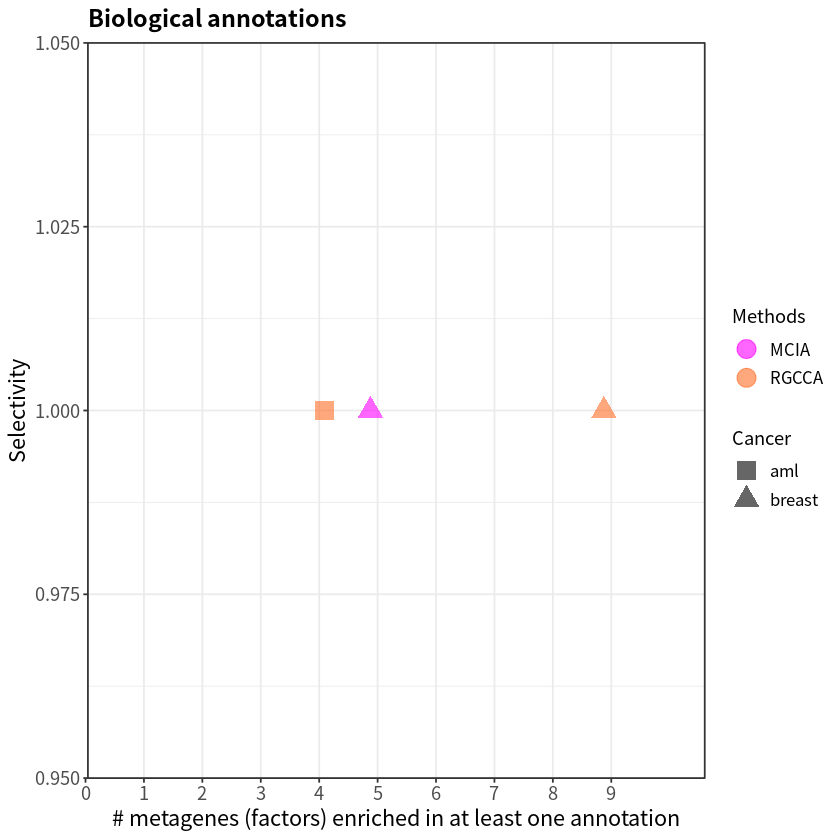

In [24]:
#tiff("BioEnr_go_fig1.tiff", units="in", width=8.95, height=6.05, res=300)
min_nonZero = min(biological_analysis[, "nonZeroFacs"]) 
max_nonZero = max(biological_analysis[, "nonZeroFacs"]) 
g <- ggplot(biological_analysis, 
            aes(x=nonZeroFacs,y=selectivity)) + 
    geom_point(aes(colour = methods, shape = cancer), size=5, alpha=.6, position=position_jitter(h=0, w=0.15))+ 
    theme_bw() + 
    scale_shape_manual(values=c(15,17,16)) + 
    scale_color_manual(values=c('#FF00FF', '#FF6E28', '#C8961E', '#FF0000', '#0000FF', '#A0A0A0', '#48D1CC', '#00FF00')) +
    ylim(floor(min((biological_analysis[,"selectivity"]*10)-.4)) / 10,
         ceiling(max((biological_analysis[,"selectivity"]*10)+.2)) / 10) +
    labs(title="Biological annotations", 
         x="# metagenes (factors) enriched in at least one annotation") +
    theme(plot.title = element_text(size=14,face="bold"),
          axis.text = element_text(size=11),
          axis.title = element_text(size=13),
          legend.text=element_text(size=10)) +
    ylab("Selectivity") + 
    labs(colour = "Methods", shape = "Cancer") +
    guides(color = guide_legend(order = 1),shape = guide_legend(order = 2),size = guide_legend(order = 3)) + 
    #scale_x_discrete() + scale_x_discrete(limits=min_nonZero:max_nonZero) + 
    scale_x_discrete(limits=min_nonZero:max_nonZero, labels = c(min_nonZero:max_nonZero));
g
#dev.off()

ggsave(paste0(results_folder, "biological_annotations.pdf"),dpi=300)
ggsave(paste0(results_folder, "biological_annotations.png"),dpi=300) 

In [25]:
library(ggplot2)

Saving 6.67 x 6.67 in image

Saving 6.67 x 6.67 in image



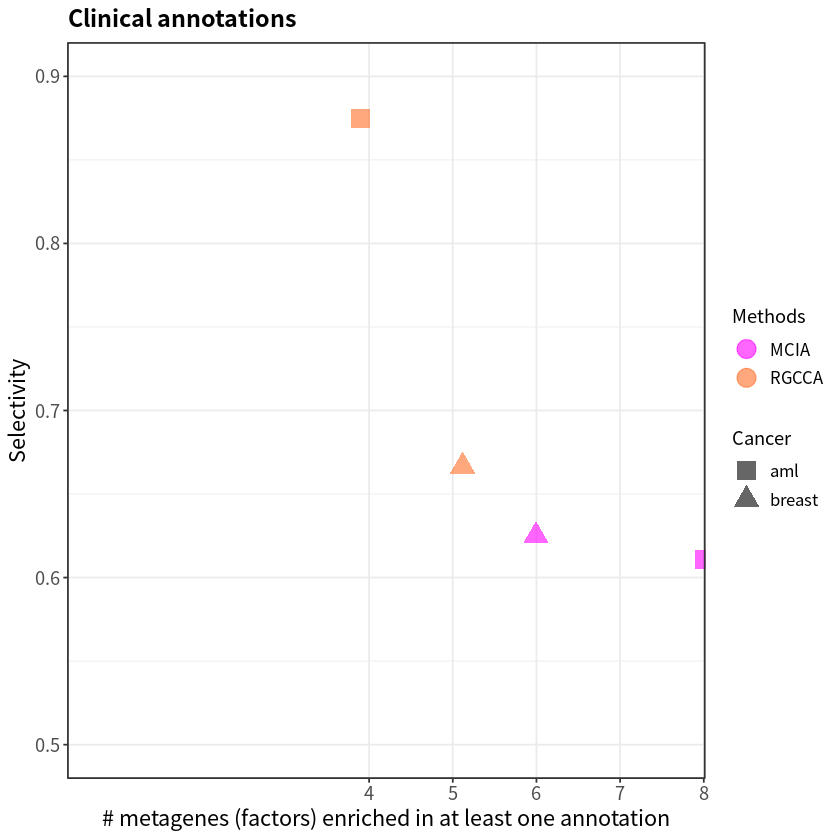

In [26]:
#tiff("BioEnr_go_fig1.tiff", units="in", width=8.95, height=6.05, res=300)
min_nonZero = min(clinical_analysis[, "nonZeroFacs"]) 
max_nonZero = max(clinical_analysis[, "nonZeroFacs"]) 
g <- ggplot(clinical_analysis, 
            aes(x=nonZeroFacs, y=selectivity)) + 
    geom_point(aes(colour = methods, shape = cancer), size=5, alpha=.6, position=position_jitter(h=0, w=0.15))+ 
    theme_bw() + 
    scale_shape_manual(values=c(15,17,16)) + 
    scale_color_manual(values=c('#FF00FF', '#FF6E28', '#C8961E', '#FF0000', '#0000FF', '#A0A0A0', '#48D1CC', '#00FF00')) +
    ylim(floor(min((clinical_analysis[,"selectivity"]*10)-.4)) / 10,
         ceiling(max((clinical_analysis[,"selectivity"]*10)+.2)) / 10) +
    labs(title="Clinical annotations", 
         x="# metagenes (factors) enriched in at least one annotation") +
    theme(plot.title = element_text(size=14,face="bold"),
          axis.text = element_text(size=11),
          axis.title = element_text(size=13),
          legend.text=element_text(size=10)) +
    ylab("Selectivity") + 
    labs(colour = "Methods",shape="Cancer") +
    guides(color = guide_legend(order = 1),shape = guide_legend(order = 2),size = guide_legend(order = 3)) + 
    #scale_x_discrete() + scale_x_discrete(limits=min_nonZero:max_nonZero) + 
    scale_x_discrete(limits=min_nonZero:max_nonZero, labels = c(min_nonZero:max_nonZero));
g
#dev.off()

ggsave(paste0(results_folder, "clinical_annotations.pdf"),dpi=300)
ggsave(paste0(results_folder, "clinical_annotations.png"),dpi=300) 